# Analysis of DeepProfiler experiment RH30

In [5]:
%matplotlib inline

import numpy as np
import pandas as pd
from tqdm import tqdm

from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import sklearn.metrics

import scipy.linalg
import scipy.spatial.distance

import matplotlib.pyplot as plt
import matplotlib
matplotlib.rc('ytick', labelsize=7)
import seaborn as sns
import os
from umap import UMAP

## Set paths and load functions

In [6]:
featdir = "outputs/results/features"

PROJECT_ROOT = "/share/data/analyses/benjamin/Single_cell_project/DP_RMS_project/"
#EXP = "cp_dataset"
#OUTPUT_FILE = "well_level_data_efn128combinedplatesout_conv6a_1e-2_e30.csv"
#MATRIX_FILE = "cos_efn128combinedplatesout_conv6a_1e-2_e30.csv"
REG_PARAM = 1e-2

In [7]:
def make_plot_custom(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    # Set the background to white
    sns.set(style="whitegrid", rc={"figure.figsize": (18, 12),'figure.dpi': 300, "axes.facecolor": "white", "grid.color": "white"})
    
    # Create a custom palette for the treatments of interest
    unique_treatments = set(embedding[colouring])
    custom_palette = sns.color_palette("hls", len(unique_treatments))
    color_dict = {treatment: color for treatment, color in zip(unique_treatments, custom_palette)}
    
    # Make the "Control" group grey
    if "DMSO_0.1%" in color_dict:
        color_dict["DMSO_0.1%"] = "lightgrey"
    
    # Create a size mapping
    size_dict = {treatment: 20 if treatment != "DMSO_0.1%" else 8 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    # Create the scatter plot
    sns_plot = sns.scatterplot(data=embedding, x="UMAP 1", y="UMAP 2", hue=colouring, size='size', palette=color_dict, sizes=(8, 25), linewidth=0.1, alpha=0.9)
    
    plt.suptitle(f"{name}_{file_name}", fontsize=16)
    sns_plot.tick_params(labelbottom=False, labelleft=False, bottom=False, left=False)
    sns_plot.set_title("CLS Token embedding of "+str(len(embedding))+" cells" + " \n"+description, fontsize=12)
    sns.move_legend(sns_plot, "lower left", title='Treatments', prop={'size': 10}, title_fontsize=12, markerscale=0.5)
    
    # Remove grid lines
    sns.despine(bottom=True, left=True)
    
    if save_dir == True:
        # Save the figure with the specified DPI
        sns_plot.figure.savefig(f"{save_dir}{file_name}{name}.png", dpi=600)  # Changed DPI to 600
        sns_plot.figure.savefig(f"{save_dir}pdf_format/{file_name}{name}.pdf", dpi=600)  # Changed DPI to 600
    
    plt.show()

import plotly.express as px
import plotly.graph_objects as go

def make_plot_custom_plotly(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    
    # Create a custom palette for the treatments of interest
    unique_treatments = set(embedding[colouring])
    custom_palette = px.colors.qualitative.Set1[:len(unique_treatments)]
    color_dict = {treatment: color for treatment, color in zip(unique_treatments, custom_palette)}
    
    # Make the "Control" group grey
    if "DMSO_0.1%" in color_dict:
        color_dict["DMSO_0.1%"] = "lightgrey"
    
    # Create a size mapping
    size_dict = {treatment: 6 if treatment != "DMSO_0.1%" else 3 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    # Create a Plotly scatter plot
    fig = px.scatter(embedding, x="UMAP 1", y="UMAP 2", color=colouring, size='size', color_discrete_map=color_dict, size_max=6, opacity=0.9, width=1000, height=700)

    # Customize the plot
    fig.update_layout(
        title={
            'text': f"{name}_{file_name} - UMAP embedding of {len(embedding)} cells \n{description}",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        plot_bgcolor='white',
        showlegend=True,
        xaxis_title="UMAP 1",
        yaxis_title="UMAP 2",
        xaxis_showgrid=False,
        yaxis_showgrid=False
    )
    
    # Remove axis ticks and labels
    fig.update_xaxes(showticklabels=False, zeroline=False)
    fig.update_yaxes(showticklabels=False, zeroline=False)

    # Save the figure if required
    if save_dir:
        fig.write_image(f"{save_dir}{file_name}{name}.png")
        fig.write_image(f"{save_dir}pdf_format/{file_name}{name}.pdf")
    
    # Show the plot
    fig.show()


import plotly.express as px
import plotly.io as pio

def make_plot_custom_plotly_print(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    
    # Define your custom color mapping based on conditions
    def get_color(val):
        if "_1" in val:
            return "#28B6D2"
        elif "_5" in val:
            return "#e96565"
        elif val == "DMSO_0.1%":
            return "lightgrey"
        else:
            return "grey"  # A default color for treatments that don't fit any of the conditions
    
    unique_treatments = set(embedding[colouring])
    color_dict = {treatment: get_color(treatment) for treatment in unique_treatments}
    low_conc = embedding[embedding[colouring].str.contains("_1")][colouring].unique()[0]
    high_conc = embedding[embedding[colouring].str.contains("_5")][colouring].unique()[0]
    # Create a size mapping
    size_dict = {treatment: 8 if treatment != "DMSO_0.1%" else 5 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    fig = go.Figure()
    df_dmso = embedding[embedding[colouring] == "DMSO_0.1%"]
    fig.add_trace(
        go.Scatter(
            x=df_dmso["UMAP 1"],
            y=df_dmso["UMAP 2"],
            mode="markers",
            marker=dict(
                color=color_dict["DMSO_0.1%"],
                size=df_dmso['size']
            ),
            name="DMSO_0.1%"
        )
    )

    # Add "_1" dots
    df_1 = embedding[embedding[colouring].str.contains("_1")]
    fig.add_trace(
        go.Scatter(
            x=df_1["UMAP 1"],
            y=df_1["UMAP 2"],
            mode="markers",
            marker=dict(
                color=color_dict[low_conc],
                size=df_1['size']
            ),
            opacity=1,
            name=str(low_conc))
        )
    

    # Add "_5" dots
    df_5 = embedding[embedding[colouring].str.contains("_5")]
    fig.add_trace(
        go.Scatter(
            x=df_5["UMAP 1"],
            y=df_5["UMAP 2"],
            mode="markers",
            marker=dict(
                color=color_dict[high_conc],
                size=df_5['size']
            ),
            opacity=1,
            name=str(high_conc)
        )
    )

    # Customize the plot
    fig.update_layout(
        width = 1200,
        height = 900,
        title={
            'text': f"{name}_{file_name} embedding of {len(embedding)} cells \n{description}",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        plot_bgcolor='white',
        showlegend=True,
        xaxis_title="UMAP 1",
        yaxis_title="UMAP 2",
        xaxis_showgrid=False,
        yaxis_showgrid=False
    )
    
    # Remove axis ticks and labels
    fig.update_xaxes(showticklabels=False, zeroline=False)
    fig.update_yaxes(showticklabels=False, zeroline=False)

    # Save the figure if required
    if save_dir:
        #pio.write_image(fig, f"{save_dir}{file_name}{name}.png", scale=3)
        pio.write_image(fig, f"{file_name}{name}.pdf", scale=3)
    
    # Show the plot
    else:
        fig.show()



## Load metadata and features

In [8]:
meta = pd.read_csv(os.path.join(PROJECT_ROOT, "inputs", "metadata", "metadata_DeepProfiler_RH30_final.csv"))
meta = meta.sort_values(by=['Metadata_Well', 'Metadata_Site'])
meta['Metadata_cmpdName'] =meta['Metadata_cmpdName'].str.upper()

In [9]:
classes = meta["Metadata_cmpdName"].unique()
classes.sort()
classes = { classes[i]:i for i in range(len(classes))}
#validation = meta[meta["replicate_use"] != "Training"]
validation = meta

In [10]:
#inspect what is in the output feature npz file

i = validation.index[0]
plate = validation.loc[i, "Metadata_Plate"]
well = validation.loc[i, "Metadata_Well"]
site = validation.loc[i, "Metadata_Site"]


filename = f"{PROJECT_ROOT}/{featdir}/{plate}/{well}/{site}.npz"
print(filename)

with open(filename, "rb") as data:
    info = np.load(data)
    print(list(info.keys()))

/share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/A01/s1.0.npz
['features', 'metadata', 'locations']


In [11]:
predictions = []
real_labels = []
wells = []
for i in tqdm(validation.index):
    plate = validation.loc[i, "Metadata_Plate"]
    well  = validation.loc[i, "Metadata_Well"]
    site  = validation.loc[i, "Metadata_Site"]
    
    filename = f"{PROJECT_ROOT}/{featdir}/{plate}/{well}/{site}.npz"
    
    try:
        with open(filename, "rb") as data:
            info = np.load(data)
            predictions.append(info["features"])
            label = validation.loc[i, "Metadata_cmpdNameConc"]
            #real_labels.append([classes[label]] * info["features"].shape[0])
            wells.append(f"{plate}_{well}")
    except FileNotFoundError:
        print(f"File {filename} not found. Skipping...")
        continue

  2%|▏         | 57/2832 [00:00<00:19, 142.60it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/A03/s5.0.npz not found. Skipping...


  4%|▍         | 117/2832 [00:00<00:18, 146.95it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/A06/s5.0.npz not found. Skipping...


 12%|█▏        | 330/2832 [00:02<00:12, 197.35it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/B06/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/B08/s6.0.npz not found. Skipping...


 16%|█▌        | 460/2832 [00:02<00:14, 163.43it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C03/s1.0.npz not found. Skipping...


 18%|█▊        | 521/2832 [00:03<00:12, 181.58it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C06/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C06/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C06/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C06/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C08/s3.0.npz not found. Skipping...


 21%|██        | 587/2832 [00:03<00:12, 176.76it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C11/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/C11/s4.0.npz not found. Skipping...


 23%|██▎       | 659/2832 [00:03<00:10, 213.40it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D03/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D03/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D03/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D03/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D03/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D03/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D06/s1.0.npz not found. Skipping...
File /share/data/ana

 25%|██▍       | 703/2832 [00:04<00:11, 187.25it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D08/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D09/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D10/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D10/s4.0.npz not found. Skipping...


 26%|██▋       | 747/2832 [00:04<00:10, 199.75it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/D11/s4.0.npz not found. Skipping...


 28%|██▊       | 791/2832 [00:04<00:10, 193.31it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E02/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E02/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E02/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E04/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E04/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E04/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E04/s5.0.npz not found. Skipping...
File /share/data/ana

 31%|███       | 872/2832 [00:04<00:08, 230.58it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E05/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E06/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E06/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E06/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E06/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E06/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E06/s6.0.npz not found. Skipping...
File /share/data/ana

 32%|███▏      | 920/2832 [00:05<00:08, 219.61it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E11/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E11/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E11/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E11/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/E11/s5.0.npz not found. Skipping...


 37%|███▋      | 1042/2832 [00:05<00:08, 214.79it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F06/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F06/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F06/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F06/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F06/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F06/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F07/s1.0.npz not found. Skipping...
File /share/data/ana

 38%|███▊      | 1088/2832 [00:05<00:07, 219.24it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/F11/s1.0.npz not found. Skipping...


 41%|████      | 1154/2832 [00:06<00:08, 190.65it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G02/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G02/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G02/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G04/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G04/s5.0.npz not found. Skipping...


 43%|████▎     | 1228/2832 [00:06<00:07, 224.34it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G06/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G07/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G08/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G08/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G08/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G09/s1.0.npz not found. Skipping...


 44%|████▍     | 1257/2832 [00:06<00:06, 242.37it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/G11/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H02/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H02/s3.0.npz not found. Skipping...


 46%|████▌     | 1306/2832 [00:07<00:07, 209.79it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H02/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H02/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H05/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H05/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H05/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H05/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H05/s5.0.npz not found. Skipping...


 48%|████▊     | 1362/2832 [00:07<00:06, 220.14it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H05/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H08/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H08/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H08/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H08/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/H08/s5.0.npz not found. Skipping...


 54%|█████▍    | 1527/2832 [00:08<00:06, 203.29it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/I05/s4.0.npz not found. Skipping...


 57%|█████▋    | 1605/2832 [00:08<00:06, 180.99it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/I09/s6.0.npz not found. Skipping...


 59%|█████▉    | 1683/2832 [00:08<00:05, 219.42it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J02/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J04/s3.0.npz not found. Skipping...


 61%|██████    | 1733/2832 [00:09<00:04, 226.17it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J06/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J06/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J08/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J08/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J08/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J08/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/J08/s6.0.npz not found. Skipping...


 65%|██████▌   | 1843/2832 [00:09<00:04, 207.42it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K03/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K03/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K03/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K03/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K05/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K05/s3.0.npz not found. Skipping...


 67%|██████▋   | 1910/2832 [00:10<00:04, 212.37it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K08/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K08/s3.0.npz not found. Skipping...


 70%|██████▉   | 1980/2832 [00:10<00:04, 205.36it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/K12/s6.0.npz not found. Skipping...


 72%|███████▏  | 2042/2832 [00:10<00:03, 253.12it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/L04/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/L07/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/L07/s4.0.npz not found. Skipping...


 75%|███████▌  | 2129/2832 [00:10<00:02, 266.49it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/L10/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/L12/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/L12/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M01/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M02/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M02/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M02/s4.0.npz not found. Skipping...
File /share/data/ana

 77%|███████▋  | 2182/2832 [00:11<00:02, 235.51it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M02/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M04/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M04/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M04/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M04/s6.0.npz not found. Skipping...


 79%|███████▉  | 2236/2832 [00:11<00:02, 227.45it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M08/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M08/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M08/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M08/s5.0.npz not found. Skipping...


 81%|████████▏ | 2305/2832 [00:11<00:02, 210.37it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M12/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M12/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M12/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M12/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/M12/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/N03/s2.0.npz not found. Skipping...


 84%|████████▍ | 2377/2832 [00:12<00:02, 212.60it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/N05/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/N05/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/N05/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/N05/s5.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/N05/s6.0.npz not found. Skipping...


 89%|████████▊ | 2512/2832 [00:12<00:01, 192.24it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O02/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O04/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O04/s3.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O04/s4.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O04/s5.0.npz not found. Skipping...


 92%|█████████▏| 2608/2832 [00:13<00:00, 230.75it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O07/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O07/s6.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O08/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O08/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O09/s1.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O09/s2.0.npz not found. Skipping...
File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/O09/s3.0.npz not found. Skipping...
File /share/data/ana

 95%|█████████▌| 2697/2832 [00:13<00:00, 182.99it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/P04/s2.0.npz not found. Skipping...


100%|█████████▉| 2821/2832 [00:14<00:00, 167.29it/s]

File /share/data/analyses/benjamin/Single_cell_project/DP_RMS_project//outputs/results/features/P014561/P10/s6.0.npz not found. Skipping...


100%|██████████| 2832/2832 [00:14<00:00, 193.97it/s]


In [12]:
import pandas as pd

rows = []
for i in tqdm(validation.index):
    plate = validation.loc[i, "Metadata_Plate"]
    well  = validation.loc[i, "Metadata_Well"]
    site  = validation.loc[i, "Metadata_Site"]
    
    filename = f"{PROJECT_ROOT}/{featdir}/{plate}/{well}/{site}.npz"
    
    try:
        with open(filename, "rb") as data:
            info = np.load(data)
            features_array = info["features"]
            
            for features in features_array:
                row = {
                    "Plate": plate,
                    "Well": well,
                    "Site": site,
                    "Label": label
                }
                for idx, feature in enumerate(features):
                    row[f"Feature_{idx}"] = feature
                
                rows.append(row)
    except FileNotFoundError:
        #print(f"File {filename} not found. Skipping...")
        continue

df = pd.DataFrame(rows)


100%|██████████| 2832/2832 [03:01<00:00, 15.58it/s]


In [13]:
# merge metadata
#meta = pd.read_csv("metadata.csv")
#meta = meta[["Metadata_cmpdName","Metadata_cmpdNameConc"]]
meta.rename(columns={"Metadata_Plate": "Plate", "Metadata_Well": "Well", "Metadata_Site": "Site"}, inplace=True)

In [14]:
df = pd.merge(df, meta, on=["Plate", "Well", "Site"])
df.head()

,Plate,Well,Site,Label,Feature_0,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,...,Metadata_cmpdNameConc,Metadata_sample_type,Metadata_cmpdConc,Metadata_CellLine,DNA,Mito,AGP,RNA,ER,Metadata_Split
0,P014561,A01,s1.0,NaN,0.270156,2.751563,3.639902,2.005968,0.686388,0.278200,...,blank,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
1,P014561,A01,s1.0,NaN,0.333880,2.815352,3.697375,2.185930,0.582844,0.331138,...,blank,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
2,P014561,A01,s1.0,NaN,0.356080,2.892081,3.960638,1.977708,0.567073,0.789425,...,blank,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
3,P014561,A01,s1.0,NaN,0.237117,2.882714,3.854625,2.057554,0.520350,0.586887,...,blank,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
4,P014561,A01,s1.0,NaN,0.405717,3.142379,3.894133,1.325141,0.763665,0.598220,...,blank,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0


In [15]:
features = [col for col in df.columns if "Feature" in col]

In [16]:
meta_features = [ col for col in df.columns if col not in features]

In [81]:
#df.to_csv("profiles_RH30_deepprofiler.csv", index = False)

In [8]:
df = pd.read_csv("profiles_RH30_deepprofiler.csv")

## Run Normalization and spherize

In [17]:
import scipy.stats
from sklearn.preprocessing import StandardScaler, RobustScaler
import pycytominer as pm

def prep_data(df1, features, meta_features, plate):
    mask = ~df1['Metadata_cmpdName'].isin(['blank', 'UNTREATED'])
    filtered_df = df1[mask]
    temp1 = filtered_df.copy()
    temp1['Metadata_cmpdName'] =temp1['Metadata_cmpdName'].str.upper()
    temp1 = temp1.loc[(temp1['Plate'] == plate)]
    data_norm = pm.normalize(profiles = temp1, features =  features, meta_features = meta_features, samples = "Metadata_cmpdName == 'DMSO'", method = "mad_robustize")
    print("Feature selection starts, shape:", data_norm.shape)
    df_selected = pm.feature_select(data_norm, features = features, operation = ['correlation_threshold', 'drop_na_columns'], corr_threshold=0.97)
    print('Number of columns removed:', data_norm.shape[1] - df_selected.shape[1])
    #out = df_selected.dropna().reset_index(drop = True)
    #print('Number of NA rows removed:', df_selected.shape[0] - out.shape[0])
    return(df_selected)

In [18]:
comp = list(df["Metadata_cmpdName"].unique())
#norm_df = prep_data(df, features, meta_features, compound = comp)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [19]:
plate = list(df["Plate"].unique())
mad_norm_df = pd.DataFrame()
for p in plate:
    temp = prep_data(df, features, meta_features, p)
    mad_norm_df = pd.concat([mad_norm_df, temp], axis = 0)

Feature selection starts, shape: (172182, 688)
Number of columns removed: 0
Feature selection starts, shape: (129055, 688)
Number of columns removed: 0
Feature selection starts, shape: (78417, 688)
Number of columns removed: 0


## Spherize batch correct

In [90]:
import pandas as pd
from sklearn.base import TransformerMixin
from zca import ZCA, ZCA_corr


def apply_norm(normalizer: TransformerMixin, dframe: pd.DataFrame, field: str,
               values):
    '''Apply normalization considering dframe[field=='value'] as training set.
    Returns the dframe normalized
    '''

    feat_cols = features
    meta_cols = meta_features
    meta = dframe[meta_cols]
    train = dframe.loc[dframe[field].isin(values), feat_cols]
    if len(train) == 0:
        raise ValueError(f'{values} not found in {field}')
    normalizer.fit(train)

    norm_feats = normalizer.transform(dframe[feat_cols])
    norm_feats = pd.DataFrame(norm_feats,
                              index=dframe.index,
                              columns=feat_cols)
    dframe = pd.concat([meta, norm_feats], axis=1)
    return dframe


def sphere(dframe: pd.DataFrame, regularization: float, mode: str,
           column_norm: str, values_norm):
    '''
    Apply sphering using 'negcon' as training set
    '''
    if mode == 'corr':
        normalizer = ZCA_corr(regularization=regularization)
    else:
        normalizer = ZCA(regularization=regularization)
    dframe = apply_norm(normalizer, dframe, column_norm, values_norm)
    return dframe, normalizer

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [108]:
spherized_df, _ = sphere(mad_norm_df, regularization = 0.001, mode = "corr", column_norm = "Metadata_cmpdName", values_norm = ["DMSO"])

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


## Harmony batch normalization

In [3]:
import anndata

## Show distribution of columns in the data

In [4]:
df

NameError: name 'df' is not defined

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


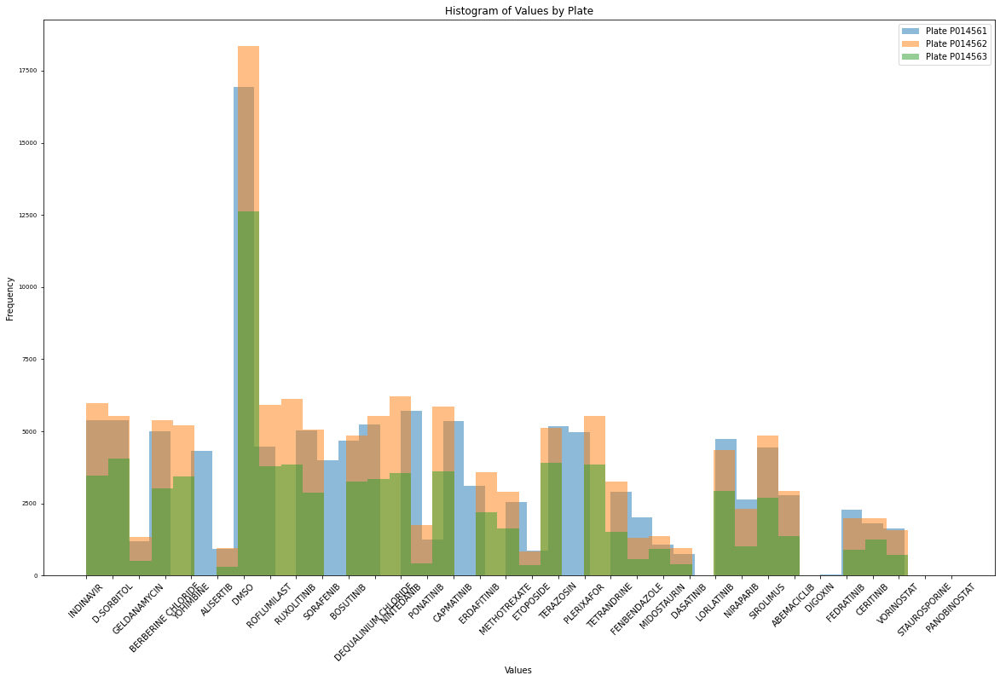

In [69]:
plt.figure(figsize=(20, 12)) 
for group, group_data in mad_norm_df.groupby('Plate'):
    plt.hist(group_data['Metadata_cmpdName'], bins=40, alpha = 0.5, label=f'Plate {group}')

# Add labels and legend
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.title('Histogram of Values by Plate')
plt.legend()
plt.xticks(rotation=45)

# Show the plot
plt.show()

### Run UMAP

In [25]:
from umap import UMAP
import seaborn as sns
import matplotlib.pyplot as plt
feature_columns = [col for col in df.columns if col.startswith("Feature_")]
features = df[feature_columns]
n_neighbors_value = 400  
min_dist_value = 0.1    

reducer = UMAP(n_neighbors=n_neighbors_value, min_dist=min_dist_value)
embedding = reducer.fit_transform(features[feature_columns])

umap_df = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
umap_df["Metadata_cmpdName"] = df["Metadata_cmpdName"]

ImportError: cannot import name 'UMAP' from 'umap' (/home/jovyan/.local/lib/python3.8/site-packages/umap/__init__.py)

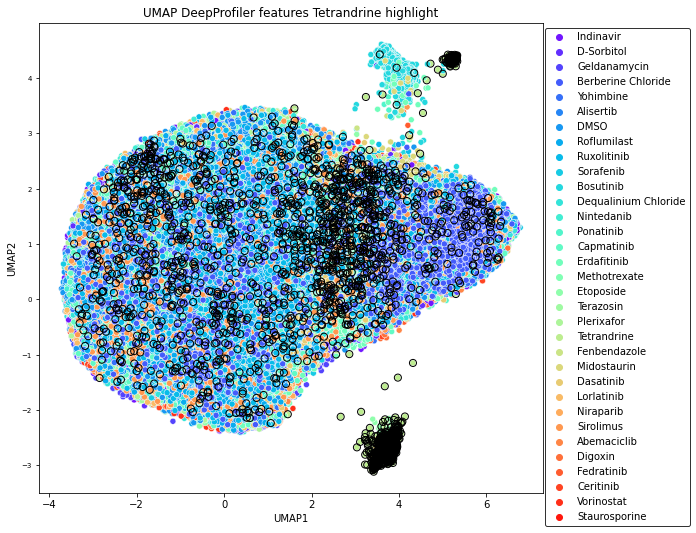

In [55]:
umap_df_noblank = umap_df[umap_df['Metadata_cmpdName'] != 'blank']
highlight_treatments = ["Tetrandrine"]
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="Metadata_cmpdName", data=umap_df_noblank, palette="rainbow")
plt.title("UMAP DeepProfiler features Tetrandrine highlight")
for treatment in highlight_treatments:
    selected_data = umap_df_noblank[umap_df_noblank['Metadata_cmpdName'] == treatment]
    plt.scatter(selected_data['UMAP1'], selected_data['UMAP2'], facecolors='none', edgecolors='black', linewidths=1, s=50)

legend = plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))

# Adjust the legend box position and size
legend.get_frame().set_edgecolor('black')  # Border color
legend.get_frame().set_linewidth(1)        # Border width
plt.tight_layout() 
plt.show()

In [30]:
feature_columns  = [col for col in df.columns if col.startswith("Feature_")]
grouped_features = df.groupby(['Plate','Well','Site'])[feature_columns].mean().reset_index()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [ ]:
pca = PCA(n_components=2)
principal_components = pca.fit_transform(grouped_features[feature_columns])

pca_df = pd.DataFrame(data=principal_components, columns=["Principal Component 1", "Principal Component 2"])
pca_df[['Plate', 'Well', 'Site']] = grouped_features[['Plate', 'Well', 'Site']]
pca_df = pd.merge(pca_df, meta, on=["Plate","Well", "Site"])

plt.figure(figsize=(10, 8))
sns.scatterplot(x="Principal Component 1", y="Principal Component 2", hue="Metadata_cmpdName", data=pca_df, palette="rainbow")
plt.title("PCA of Mean Features Colored by Well")
plt.show()

In [133]:
import seaborn as sns
import matplotlib.pyplot as plt

n_neighbors_value = 35
min_dist_value = 0.1
#mask = ~df['Metadata_cmpdName'].isin(['blank', 'UNTREATED'])

# Use the mask to filter the DataFrame and keep only the desired rows
filtered_df = spherized_df
grouped_features = filtered_df.groupby(['Plate','Well', 'Site'])[feature_columns].mean().reset_index()

reducer = UMAP(n_neighbors=n_neighbors_value, min_dist=min_dist_value)
embedding = reducer.fit_transform(grouped_features[feature_columns])

umap_df = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
umap_df[['Plate', 'Well', 'Site']] = grouped_features[['Plate', 'Well', 'Site']]

umap_df = pd.merge(umap_df, meta, on=["Plate", "Well", "Site"])


/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


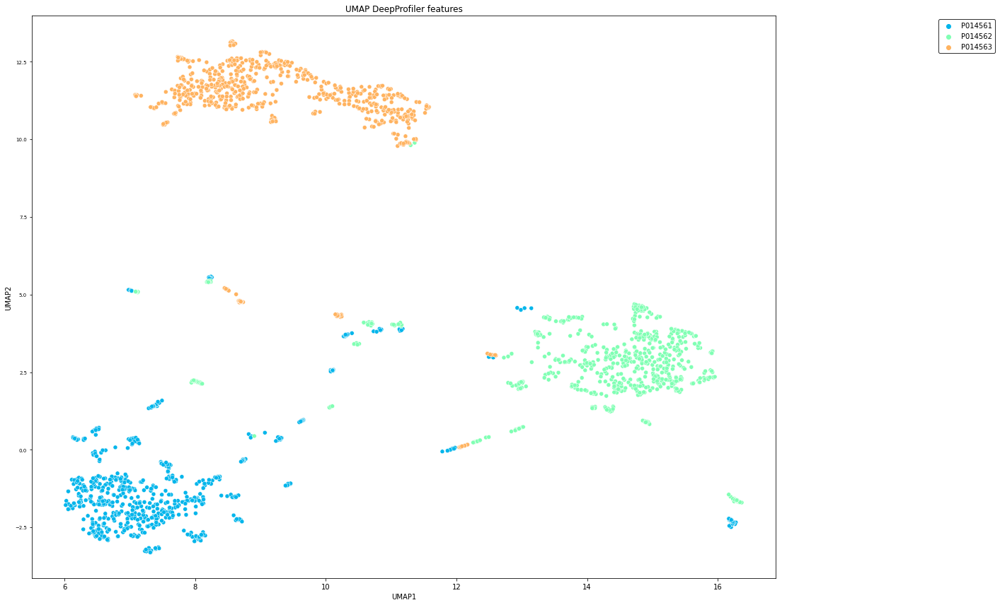

In [135]:
plt.figure(figsize=(20, 12))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="Plate", data=umap_df, palette="rainbow")
plt.title("UMAP DeepProfiler features")
legend = plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))

# Adjust the legend box position and size
legend.get_frame().set_edgecolor('black')  # Border color
legend.get_frame().set_linewidth(1)        # Border width
plt.tight_layout()    
plt.show()

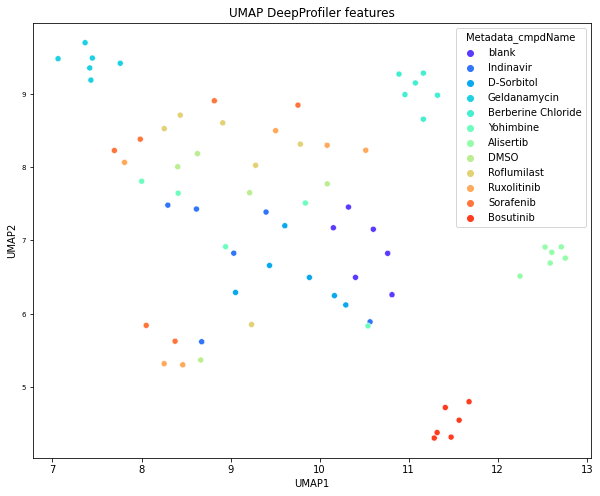

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt
df_B_wells = df[df['Well'].str.startswith('B')]
n_neighbors_value = 15  
min_dist_value = 0.1    

grouped_features = df_B_wells.groupby(['Plate','Well', 'Site'])[feature_columns].mean().reset_index()

reducer = UMAP(n_neighbors=n_neighbors_value, min_dist=min_dist_value)
embedding = reducer.fit_transform(grouped_features[feature_columns])

umap_df = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
umap_df[['Plate', 'Well', 'Site']] = grouped_features[['Plate', 'Well', 'Site']]

umap_df = pd.merge(umap_df, meta, on=["Plate", "Well", "Site"])

plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="Metadata_cmpdName", data=umap_df, palette="rainbow")
plt.title("UMAP DeepProfiler features")
plt.show()

## Run PCA on features

In [16]:
def run_pca(df, plot = True):
    x = df.drop(columns=meta_features)
    #.clip(lower = -50, upper=50)
    pca = PCA(n_components=2)

    principalComponents = pca.fit_transform(x)
    principalDf = pd.DataFrame(data = principalComponents)
    principalDf.rename(columns={0: 'pc1', 1: 'pc2', 2: 'pc 3'}, inplace=True)
    principal_out = pd.concat([principalDf, df[meta_features].reset_index()], axis = 1)
    #principalDf = pd.concat([principalDf].reset_index(), axis = 1).dropna()
    variance_ratio = pca.explained_variance_ratio_
    if plot:
        fig = plt.figure(figsize = (14,6))
        ax = fig.add_subplot(111) 
        ax.set_xlabel('PC 1: {:.2%}'.format(variance_ratio[0]), fontsize = 10)
        ax.set_ylabel('PC 2: {:.2%}'.format(variance_ratio[1]), fontsize = 10)
        ax.spines['top'].set_color('w')
        ax.spines['right'].set_color('w')
        ax.spines['left'].set_color('grey')
        ax.spines['bottom'].set_color('grey')
            #colors = [ 'grey', 'lime'] #, 'lime',  'darkorange', 'red',  'purple' #,'navy', 'sienna']

        ax =sns.scatterplot(x='pc1', y='pc2', data=principalDf, palette='bright',  s=10, alpha = 0.8,  marker = 'o');
        for i, var in enumerate(pca.components_.T):
            plt.arrow(0, 0, var[0]*max(principalDf["pc1"]), var[1]*max(principalDf["pc2"]), 
                    head_width=0.2, head_length=0.2, linewidth=2, color='red')
            plt.text(var[0]*max(principalDf["pc1"]), var[1]*max(principalDf["pc2"]), x.columns[i], color='red')
        ax.set_facecolor('w')        
        #ax.get_legend().remove()
        ax.grid(False)

        plt.subplots_adjust(top=0.85, wspace=0.1, hspace=0.1, right = 1)
        fig.suptitle('PCA, {}, {}, plate'.format("Single cell data", "RH30"), fontsize = 12)
            #fig.savefig('{}/{}_{}_PCA_DMSOandContrComps.{}'.format(OutputDir,  project, CellLine, figformat),  dpi=150, bbox_inches='tight')
            #fig.savefig('{}/{}_PCA_DMSOandContrComps.{}'.format(OutputDir,  project, 'pdf'),  dpi=150, bbox_inches='tight')
        plt.show()
        return principal_out
    else:
        return principal_out


/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [25]:
def make_plot_custom_plotly_pca(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    
    # Create a custom palette for the treatments of interest
    unique_treatments = set(embedding[colouring])
    custom_palette = px.colors.qualitative.Set1[:len(unique_treatments)]
    color_dict = {treatment: color for treatment, color in zip(unique_treatments, custom_palette)}
    
    # Make the "Control" group grey
    if "DMSO 0 RH30" in color_dict:
        color_dict["DMSO 0 RH30"] = "lightgrey"
    
    # Create a size mapping
    size_dict = {treatment: 6 if treatment != "DMSO 0 RH30" else 3 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    # Create a Plotly scatter plot
    fig = px.scatter(embedding, x="pc1", y="pc2", color=colouring, size='size', color_discrete_map=color_dict, size_max=6, opacity=0.9, width=1100, height=700)

    # Customize the plot
    fig.update_layout(
        title={
            'text': f"{name}_{file_name} - CLS Token embedding of {len(embedding)} cells \n{description}",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        plot_bgcolor='white',
        showlegend=True,
        xaxis_title="pacmap 1",
        yaxis_title="pacmap 2",
        xaxis_showgrid=False,
        yaxis_showgrid=False
    )
    
    # Remove axis ticks and labels
    fig.update_xaxes(showticklabels=False, zeroline=False)
    fig.update_yaxes(showticklabels=False, zeroline=False)

    # Save the figure if required
    if save_dir:
        #pio.write_image(fig, f"{save_dir}{file_name}{name}.png", scale=3)
        pio.write_image(fig, f"{file_name}{name}.pdf", scale=3)
    
    # Show the plot
    #fig.show()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [61]:
compounds = ["Alisertib", "Bosutinib", "Fenbendazole", "Methotrexate", "Midostaurin", "Niraparib"]
for c in compounds:
    test_pca = run_pca(mad_norm_df[mad_norm_df["Metadata_cmpdName"].isin(["DMSO", c])], plot = False)
    make_plot_custom_plotly_print(test_pca, "Metadata_cmpdNameConc", save_dir = True, file_name = c, name ="PCA" )

## DMSO only UMAP on RAW features

In [16]:
from umap import UMAP
import seaborn as sns
import matplotlib.pyplot as plt
#feature_columns = [col for col in df.columns if col.startswith("Feature_")]
#features = df[feature_columns]
n_neighbors_value = 130  
min_dist_value = 0.01    
features_DMSO = mad_norm_df[mad_norm_df['Metadata_cmpdName'].isin(['DMSO', "Bosutinib"])]

reducer = UMAP(n_neighbors=n_neighbors_value, min_dist=min_dist_value, random_state = 42)
embedding = reducer.fit_transform(features_DMSO[features])

#umap_DMSO = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
umap_DMSO = features_DMSO.filter([col for col in features_DMSO.columns if col in meta_features])
umap_DMSO["UMAP 1"] = embedding[:, 0]
umap_DMSO["UMAP 2"] = embedding[:, 1]

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.


In [49]:
make_plot_custom_plotly(umap_DMSO, colouring = "Metadata_cmpdNameConc" , file_name = "DeepProfiler", name = "UMAP", description= "")

NameError: name 'umap_DMSO' is not defined

In [84]:
make_plot_custom_plotly_print(res, colouring= "Metadata_cmpdNameConc", file_name = k, name = "UMAP", description= "")

## Compound embeddings

/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



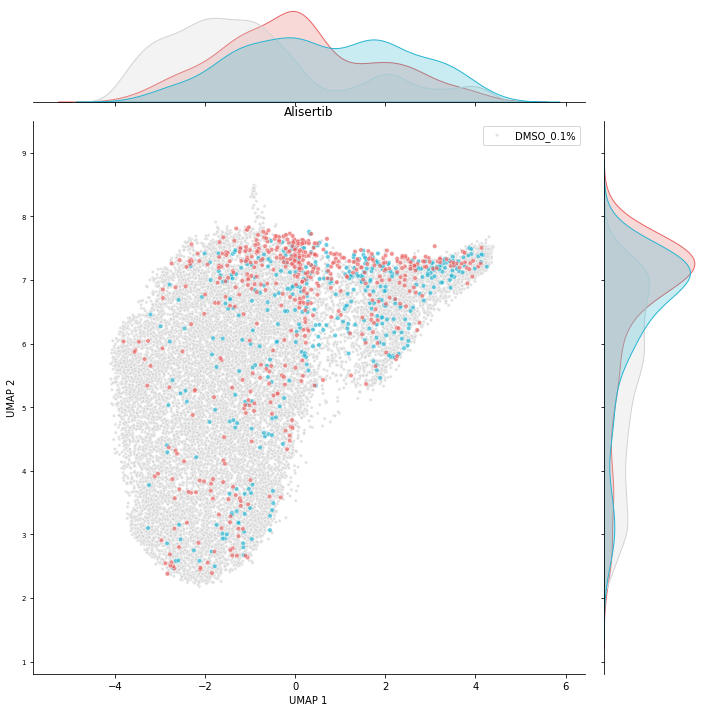

/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



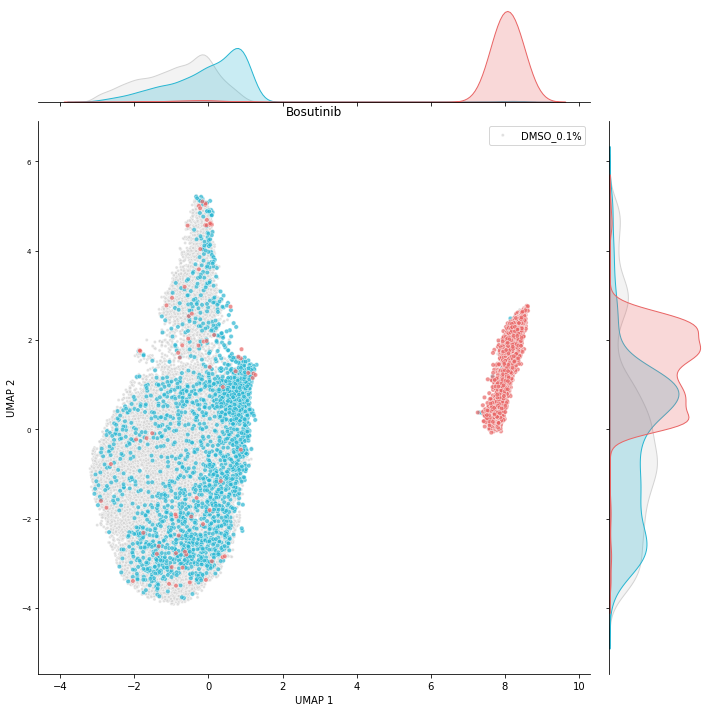

/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



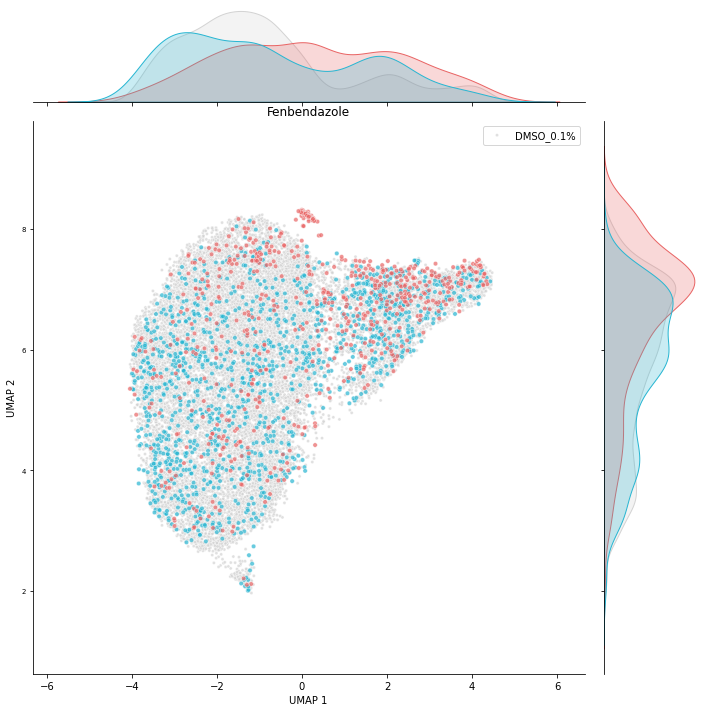

/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



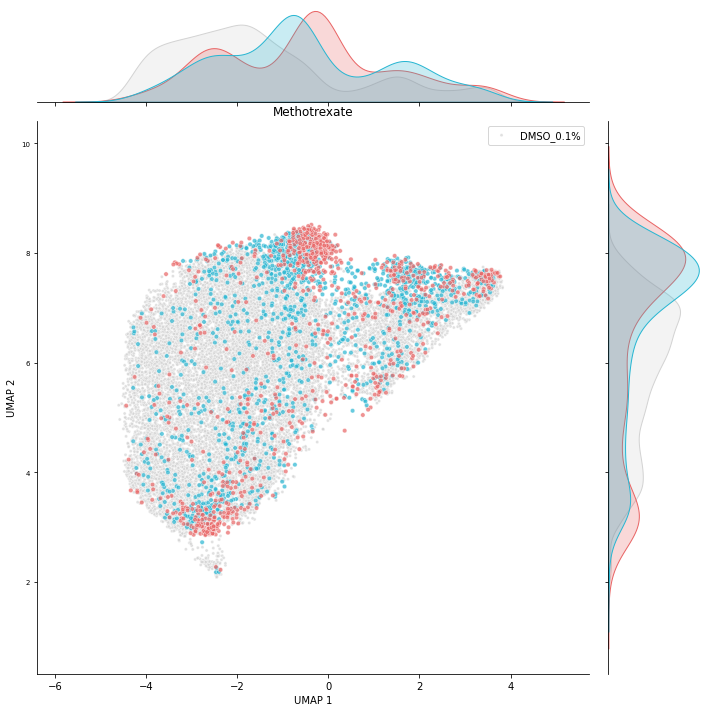

/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



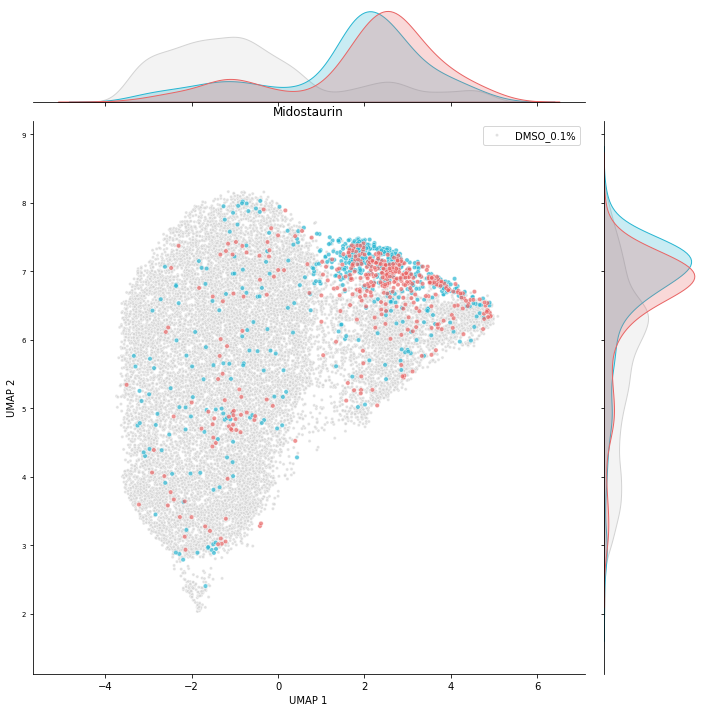

/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



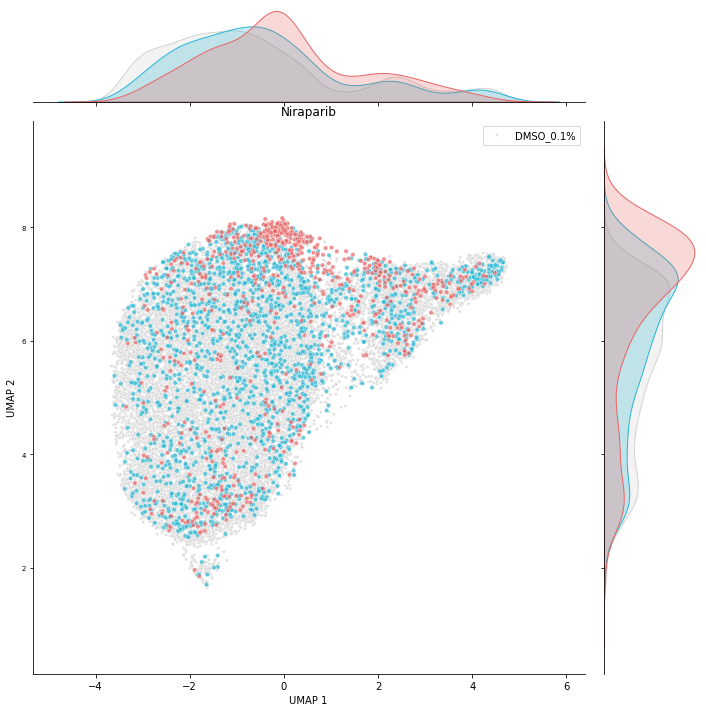

In [31]:
#comp_embeddings = {}
compounds = ["Alisertib", "Bosutinib", "Fenbendazole", "Methotrexate", "Midostaurin", "Niraparib"]
for k in compounds:
    dat = mad_norm_df[mad_norm_df['Metadata_cmpdName'].isin(['DMSO', k])]
    reducer = UMAP(n_neighbors=130, min_dist=0.01, random_state = 42)
    embedding = reducer.fit_transform(dat[features])  
    res = dat.filter([col for col in dat.columns if col in meta_features])
    res["UMAP 1"] = embedding[:, 0]
    res["UMAP 2"] = embedding[:, 1]
    make_jointplot_seaborn(res, "Metadata_cmpdNameConc",k)
    #make_plot_custom_plotly_print(res, colouring= "Metadata_cmpdNameConc", save_dir = True, file_name = k, name = "UMAP", description= "")

## Joinplot

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt


import seaborn as sns
import matplotlib.pyplot as plt

def make_jointplot_seaborn(embedding, colouring, cmpd):
    
    # Define your custom color mapping based on conditions
    def get_color(val):
        if "_1" in val:
            return "#28B6D2"
        elif "_5" in val:
            return "#e96565"
        elif val == "DMSO_0.1%":
            return "lightgrey"
        else:
            return "grey"
    
    # Size mapping
    def get_size(val):
        return 20 if val != "DMSO_0.1%" else 10
    
    embedding['color'] = embedding[colouring].apply(get_color)
    embedding['size'] = embedding[colouring].apply(get_size)
    
    # Create the base joint plot
    g = sns.JointGrid(x='UMAP 1', y='UMAP 2', data=embedding, height=10)

    # Plot KDE plots for each category
    for treatment in embedding[colouring].unique():
        subset = embedding[embedding[colouring] == treatment]
        
        sns.kdeplot(x=subset["UMAP 1"], ax=g.ax_marg_x, fill=True, color=get_color(treatment), legend=False)
        sns.kdeplot(y=subset["UMAP 2"], ax=g.ax_marg_y, fill=True, color=get_color(treatment), legend=False)

    # Ensure plotting order: first DMSO_0.1%, then _1, and finally _5
    for treatment in ["DMSO_0.1%", "_1", "_5"]:
        subset = embedding[embedding[colouring].str.contains(treatment)]
        g.ax_joint.scatter(subset["UMAP 1"], subset["UMAP 2"], c=subset['color'], s=subset['size'], label=treatment, alpha=0.7, edgecolor='white', linewidth=0.5)
    
    g.ax_joint.set_title(cmpd)
    g.ax_joint.legend()

    plt.show()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



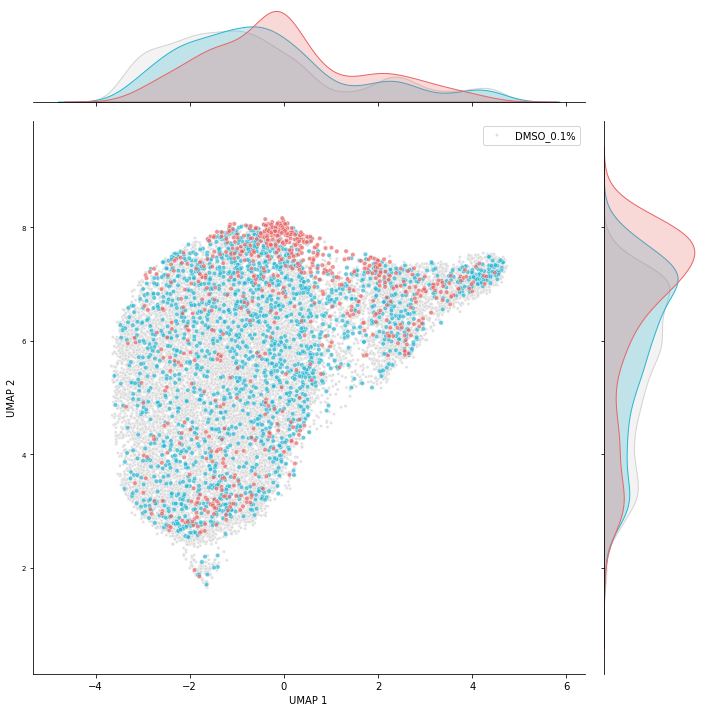

In [27]:
make_jointplot_seaborn(res, "Metadata_cmpdNameConc")

## PACMAP analysis

In [24]:
import pacmap

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [25]:
X = norm_df[features]
X.values

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


array([[-1.048713  , -0.03507975, -0.26126963, ...,  1.3689268 ,
        -1.5466086 , -0.10447084],
       [-0.7199629 ,  0.05925973,  0.4285289 , ...,  2.7186828 ,
        -1.3019154 ,  0.29342988],
       [-0.36921933,  0.58322173, -1.0569546 , ..., -0.19892919,
        -0.17564887,  0.06288963],
       ...,
       [ 0.37786308,  0.37904716, -0.15239714, ..., -0.3725151 ,
         0.24538076, -0.97727257],
       [-0.45061097, -0.55219734, -0.22545446, ...,  0.741058  ,
        -0.37141886, -0.30735603],
       [ 0.12353913,  0.714219  ,  0.50728816, ..., -0.88985664,
        -1.1756591 , -1.8410692 ]], dtype=float32)

In [26]:
embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 

# fit the data (The index of transformed data corresponds to the index of the original data)
X_transformed = embedding.fit_transform(X.values, init="pca")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


## DMSO PACMAP

In [63]:
def run_pacmap(norm_df, cmpd = None):
    if cmpd == None:
        norm_df_filt = norm_df[norm_df["Metadata_cmpdName"] == "DMSO"]
        X = norm_df_filt[features]
        embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
        X_transformed = embedding.fit_transform(X.values, init="pca")
    else:
        norm_df_filt_DMSO = norm_df[norm_df["Metadata_cmpdName"] == "DMSO"]
        X_DMSO = norm_df_filt_DMSO[features]
        embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
        X_transformed_DMSO = embedding.fit_transform(X_DMSO.values, init="pca")
        X_transformed_DMSO_df = pd.DataFrame(X_transformed_DMSO)
        pacmap_df_DMSO = pd.concat([X_transformed_DMSO_df, norm_df_filt_DMSO[meta_features].reset_index()], axis = 1)

        norm_df_cmpd = norm_df[norm_df["Metadata_cmpdName"] == cmpd]
        X_cmpd = norm_df_cmpd[features]
        X_transformed_cmpd = embedding.transform(X_cmpd.values, basis = X_DMSO.values)
        X_transformed_cmpd_df = pd.DataFrame(X_transformed_cmpd)
        pacmap_df_cmpd = pd.concat([X_transformed_cmpd_df, norm_df_cmpd[meta_features].reset_index()], axis = 1)


        pacmap_df = pd.concat([pacmap_df_DMSO, pacmap_df_cmpd], axis = 0)
    #fig, ax = plt.subplots(1, 1, figsize=(6, 6))
    fig = px.scatter(pacmap_df, x=0, y=1, color="Metadata_cmpdNameConc", 
                    opacity=0.9, width=1000, height=1000)

    fig.update_layout(
    title=f"PACMAP of compound",
    plot_bgcolor='white', 
    xaxis_title="pacmap 1",
    yaxis_title="pacmap 2",
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(showgrid=False, zeroline=False)
    
    )

    fig.update_traces(marker=dict(line=dict(width=0.1, color='Black')))
    # Show the plot
    fig.show()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
norm_df_filt_DMSO = norm_df[norm_df["Metadata_cmpdName"] == "DMSO"]
X_DMSO = norm_df_filt_DMSO[features]
embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
X_transformed_DMSO = embedding.fit_transform(X_DMSO.values, init="pca")
X_transformed_DMSO_df = pd.DataFrame(X_transformed_DMSO)
pacmap_df_DMSO = pd.concat([X_transformed_DMSO_df, norm_df_filt_DMSO[meta_features].reset_index()], axis = 1)

In [82]:
compound_list = ["Alisertib", "Bosutinib", "Fenbendazole", "Methotrexate", "Midostaurin", "Niraparib"]

for c in compound_list:
    norm_df_cmpd = norm_df[norm_df["Metadata_cmpdName"] == c]
    X_cmpd = norm_df_cmpd[features]
    X_transformed_cmpd = embedding.transform(X_cmpd.values, basis = X_DMSO.values)
    X_transformed_cmpd_df = pd.DataFrame(X_transformed_cmpd)
    pacmap_df_cmpd = pd.concat([X_transformed_cmpd_df, norm_df_cmpd[meta_features].reset_index()], axis = 1)
    pacmap_df = pd.concat([pacmap_df_DMSO, pacmap_df_cmpd], axis = 0)
    make_plot_custom_plotly(pacmap_df, "Metadata_cmpdNameConc", name = "PACMAP", file_name = c, description = "")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [84]:
df_filt_DMSO = df[df["Metadata_cmpdName"] == "DMSO"]
X2_DMSO = df_filt_DMSO[features]
embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
X2_transformed_DMSO = embedding.fit_transform(X2_DMSO.values, init="pca")
X2_transformed_DMSO_df = pd.DataFrame(X2_transformed_DMSO)
pacmap2_df_DMSO = pd.concat([X2_transformed_DMSO_df, df_filt_DMSO[meta_features].reset_index()], axis = 1)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [85]:
make_plot_custom_plotly(pacmap2_df_DMSO, "Metadata_cmpdNameConc")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [80]:
make_plot_custom_plotly(pacmap_df, "Metadata_cmpdNameConc", name )

In [ ]:
HAHAHAHAHAHAAH